## TODO
### Different color componenrs -> (grayscale + clahe the best)

### Add color filter of hairs
### Size filter of cc (13, 7 for bia)
### ~different SE + thresholds (Brias worls the best)

Try calculating histograms of color components for hair/not hair masks for both hats and see if hair should be more on left/right then not hair

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from skimage import data, img_as_float
from skimage import exposure
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
import tqdm
from sklearn.neighbors import KernelDensity


from tqdm import tqdm
from collections import Counter

import os
import sys
sys.path.append(os.path.abspath('../skin-lesion-cad'))
from utils.visualization_utils import simple_im_show, simple_im_show2

NP = '../'
image = cv2.imread(NP+'data/raw/chall1/train/nevus/nev00010.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

img_ch= image[:,:,1]

In [10]:
ch1_path = Path('/home/vzalevskyi/uni/MAIA_Semester_3/cad/skin-lesion-cad/data/raw/chall1')

nevus_path = ch1_path/'train/nevus'
random_nevus_img = np.random.choice(list(nevus_path.glob('*')), size=50)

other_path = ch1_path/'train/others'
random_other_img = np.random.choice(list(other_path.glob('*')), size=50)

# Test Hair Removal

In [11]:
from utils.hair_removal import HairRemoval

hr = HairRemoval()

In [12]:
# Turn interactive plotting off
# plt.ioff()

In [13]:
with open('test_hairs.txt', 'r') as f:
    test_filenames = f.readlines()

test_filenames = [other_path/x.strip() for x in test_filenames]

In [14]:
def lab2abfeat(test_image_lab, mask):
    acomp = test_image_lab[:,:, 1][mask].ravel()
    bcomp = test_image_lab[:,:, 2][mask].ravel()
    return np.vstack([acomp, bcomp]).T

In [15]:
def color_filter(white_hair, black_hair, image_lab):
    _, labels_white  = cv2.connectedComponentsWithAlgorithm(
    white_hair, 4, cv2.CV_32S, cv2.CCL_WU)
    _, labels_black = cv2.connectedComponentsWithAlgorithm(
    black_hair, 4, cv2.CV_32S, cv2.CCL_WU)
    
    not_hair_mask = ~(labels_white > 0) | ~(labels_black > 0)
    ab_not_hair = np.vstack([image_lab[:, :, 1][not_hair_mask].ravel(),
                                image_lab[:, :, 2][not_hair_mask].ravel()])
    kd = KernelDensity(bandwidth=0.1).fit(ab_not_hair.T)

    resulted_mask_black = np.zeros(not_hair_mask.shape)
    for bcc in np.unique(labels_black):
        cc_mask = (labels_black == bcc)
        if bcc==0:
            continue
        a_mean = image_lab[:, :, 1][cc_mask].mean().astype(np.uint8)
        b_mean = image_lab[:, :, 2][cc_mask].mean().astype(np.uint8)
    
        resulted_mask_black += kd.score([[a_mean, b_mean]])*cc_mask
        
    resulted_mask_white = np.zeros(not_hair_mask.shape)
    for bcc in np.unique(labels_white):
        cc_mask = (labels_white == bcc)
        if bcc==0:
            continue
        a_mean = image_lab[:, :, 1][cc_mask].mean().astype(np.uint8)
        b_mean = image_lab[:, :, 2][cc_mask].mean().astype(np.uint8)
        resulted_mask_white += kd.score([[a_mean, b_mean]])*cc_mask
    return resulted_mask_black, resulted_mask_white

In [16]:
for fn in tqdm(list(random_other_img)+list(random_nevus_img)):
    test_image = cv2.imread(str(fn))
    test_image = cv2.resize(test_image, (512, 512))
    test_image_lab = cv2.cvtColor(test_image, cv2.COLOR_RGB2Luv)
    test_image_bgr = cv2.cvtColor(test_image, cv2.COLOR_RGB2BGR)
    hr_channel_gray = cv2.createCLAHE(clipLimit=2.0,tileGridSize=(8,8)).apply(cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY))
    # hair_mask = hr.remove_hair(hr_channel, er_threshold=100)
    mask_black, mask_white, mask_black_filtered, mask_white_filtered = hr.remove_hair(hr_channel_gray, er_threshold=100)
    merged_masks = mask_black_filtered + mask_white_filtered
    merged_masks[merged_masks>255] = 255
    merged_masks = cv2.dilate(merged_masks, np.ones((3,3), np.uint8), iterations=1)
    # no_hair_ab = lab2abfeat(test_image_lab, ~(merged_masks>0))
    # kd = KernelDensity().fit(no_hair_ab)
    
    resulted_mask_black, resulted_mask_white = color_filter(mask_white_filtered, mask_black_filtered, test_image_lab)
    
    inpainted_img = cv2.inpaint(test_image_bgr, merged_masks.astype(np.uint8), 3, cv2.INPAINT_TELEA)
    
    fig, axs = plt.subplots(3,3,figsize=(16, 12))
    axs[0, 0].imshow(test_image_bgr)
    axs[0, 0].set_title('Original + grayscale clahe')
    axs[0, 0].axis('off')
    axs[1, 0].imshow(inpainted_img, cmap='gray')
    axs[1, 0].axis('off')
    axs[2, 0].imshow(hr.plot_hair_contours(test_image_bgr, merged_masks))
    axs[2, 0].axis('off')
    
    # black_scores = kd.score_samples(lab2abfeat(test_image_lab, mask_black_filtered>0))
    axs[0, 1].imshow(-resulted_mask_black, cmap='gray')
    axs[0, 1].set_title('black')     
    axs[0, 1].axis('off')
    axs[1, 1].imshow(mask_black_filtered, cmap='gray')
    axs[1, 1].axis('off')
    axs[2, 1].imshow(hr.plot_hair_contours(test_image_bgr, mask_black_filtered))
    axs[2, 1].axis('off')
    # axs[3, 1].hist2d(test_image_lab[:,:,1][mask_black_filtered>0].flatten(), test_image_lab[:,:,2][mask_black_filtered>0].flatten(), bins=64)
    
    # white_scores = kd.score_samples(lab2abfeat(test_image_lab, mask_white_filtered>0))
    axs[0, 2].imshow(-resulted_mask_white, cmap='gray')
    axs[0, 2].set_title('white')
    axs[0, 2].axis('off')
    axs[1, 2].imshow(mask_white_filtered, cmap='gray')
    axs[1, 2].axis('off')
    axs[2, 2].imshow(hr.plot_hair_contours(test_image_bgr, mask_white_filtered))
    axs[2, 2].axis('off')
    # axs[3, 2].hist2d(test_image_lab[:,:,1][mask_white_filtered>0].flatten(), test_image_lab[:,:,2][mask_white_filtered>0].flatten(), bins=64)

    # axs[3, 0].get_shared_x_axes().join(axs[3, 1], axs[3, 2])

    # axs[0, 3].imshow(hr_channel_gray, cmap='gray')
    # axs[0, 3].set_title('gray')
    # axs[0, 3].axis('off')
    # axs[1, 3].imshow(cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(hr_channel_gray), cmap='gray')
    # axs[1, 3].axis('off')
    
    # axs[0, 1].imshow(hr_channel_l)
    # axs[0, 1].axis('off')
    # axs[1, 1].imshow(cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(hr_channel_l))
    # axs[1, 1].axis('off')
    
    plt.tight_layout()
    plt.savefig(f"/home/vzalevskyi/uni/MAIA_Semester_3/cad/skin-lesion-cad/notebooks/test_results/{fn.name}mb.jpg")
    plt.close(fig)

100%|██████████| 100/100 [04:07<00:00,  2.47s/it]


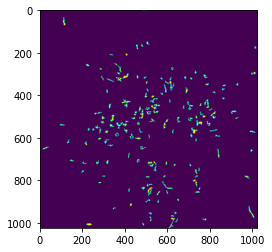

In [20]:
plt.imshow(mask_white_filtered)

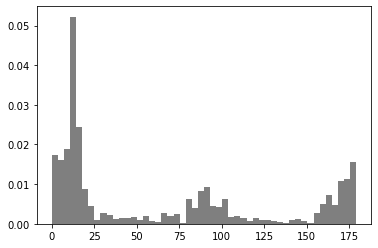

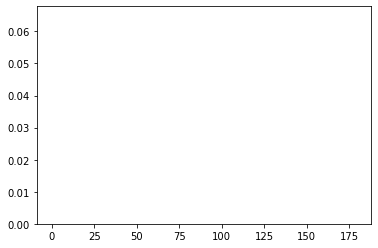

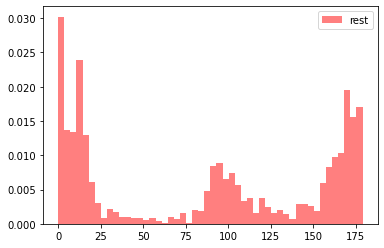

In [14]:
image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
black_hair_h = image_hsv[:,:,0][mask_black_filtered>0]
white_hair_f = image_hsv[:,:,0][mask_white_filtered>0]
rest_image = image_hsv[:,:,0][merged_masks==0]

plt.hist(black_hair_h, bins=50, alpha=0.5, label='black', color='black',  density=1)
plt.show()
plt.hist(white_hair_f, bins=50, alpha=0.5, label='white', color='white',  density=1)
plt.show()
plt.hist(rest_image, bins=50, alpha=0.5, label='rest', color='red',  density=1)
plt.legend(loc='upper right')
plt.show()

In [6]:
# for fn in tqdm.tqdm(test_filenames):
#     test_image = cv2.imread(str(fn))
#     test_image_bgr = cv2.cvtColor(test_image, cv2.COLOR_RGB2BGR)
#     luv_image = cv2.cvtColor(test_image, cv2.COLOR_RGB2LUV)
#     test_image_clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(test_image)

#     hr_channel_l = luv_image[:,:,0]
#     hr_channel_u = luv_image[:,:,1]
#     hr_channel_gray = cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY)
#     hr_channel = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(hr_channel)
#     # hair_mask = hr.remove_hair(hr_channel, er_threshold=100)
    
#     fig, axs = plt.subplots(2,4,figsize=(15,30))
#     axs[0, 0].imshow(test_image_bgr)
#     axs[0, 0].axis('off')
#     axs[0, 1].imshow(hr.plot_hair_contours(test_image_bgr, hair_mask))
#     axs[0, 1].axis('off')
#     axs[1, 0].imshow(hr_channel, cmap='gray')
#     axs[1, 0].axis('off')
#     # axs[3].imshow(adaptive_principal_curvatures, cmap='gray')
#     # axs[3].axis('off')
#     # axs[4].imshow(adaptive_principal_curvatures_bin, cmap='gray')
#     # axs[4].axis('off')
#     plt.tight_layout()
#     plt.savefig(f"/home/vzalevskyi/uni/MAIA_Semester_3/cad/skin-lesion-cad/notebooks/test_results/{fn.name}")
#     plt.close(fig)

100%|██████████| 50/50 [00:30<00:00,  1.67it/s]


In [53]:
def create_fb(width=13, height=5, n=16):
    #// check preconditions
    if width%2 == 0 :
        raise ArithmeticError#throw ucas::Error(ucas::strprintf("Structuring element width (%d) is not odd", width));
    if height%2 == 0:
        raise ArithmeticError#throw ucas::Error(ucas::strprintf("Structuring element height (%d) is not odd", height));

    
    base = np.zeros((width, width))
    #// workaround: cv::line does not work properly when thickness > 1. So we draw line by line.
    for k in range(width//2-height//2, width//2+height//2 + 1):
        cv2.line(base, (0,k), (width, k), 255)
    SEs = []
    # // compute rotated SEs
    SEs.append(base.astype(np.uint8))
    angle_step = 180.0/n
    for k in range(1, n):
        se = cv2.warpAffine(base, cv2.getRotationMatrix2D((base.shape[1]//2, base.shape[0]//2), k*angle_step, 1.0), (width, width))
        SEs.append(se.astype(np.uint8))

    return SEs

In [52]:
create_fb(13, 5, 16)[0]

array([[  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.],
       [255., 255., 255., 255., 255., 255., 255., 255., 255., 255., 255.,
        255., 255.],
       [255., 255., 255., 255., 255., 255., 255., 255., 255., 255., 255.,
        255., 255.],
       [255., 255., 255., 255., 255., 255., 255., 255., 255., 255., 255.,
        255., 255.],
       [255., 255., 255., 255., 255., 255., 255., 255., 255., 255., 255.,
        255., 255.],
       [255., 255., 255., 255., 255., 255., 255., 255., 255., 255., 255.,
        255., 255.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.],
       [  0.,   0.,   0.,   0.,   0.,   0.,   0., 

In [54]:
def brias_hair(image, hat='black'):
    sum_of_hats = np.zeros(image.shape)
    SEs = create_fb(13, 5, 16)
    for se in SEs:
        if hat == 'black':
            sum_of_hats += cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, se)
        else:
            sum_of_hats += cv2.morphologyEx(image, cv2.MORPH_TOPHAT, se)

    sum_of_hats = (255*(sum_of_hats/sum_of_hats.max())).astype(np.uint8)
    return sum_of_hats

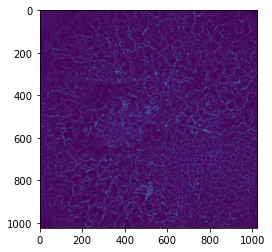

In [56]:
plt.imshow(brias_hair(hr_channel_gray, hat='black'))

# R&D Hair Removal

In [3]:
def elongate_function(outspread_len:dict, real_areas:dict) -> dict:
    """Calculated elongation function for each hair connected component.
    
    Based on "PDE-based unsupervised repair of hair-occluded information
    in dermoscopy images of melanoma," 
    https://doi.org/10.1016/j.compmedimag.2009.01.003

    Args:
        outspread_len (dict): _description_
        real_areas (dict): _description_
    Returns:
        dict: _description_
    """
    # ignore background label 0
    return {k:(outspread_len[k]**2)/real_areas[k] for k in outspread_len.keys() if k != 0}

In [4]:
p = random_nevus_img[0]

In [43]:
final_mask.max()

255

In [10]:
blackhat

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [2, 2, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [3, 3, 0, ..., 0, 0, 0]], dtype=uint8)

In [11]:
bhg

array([[0, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 0],
       [1, 1, 1, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0],
       [1, 1, 0, ..., 0, 0, 0]], dtype=uint8)

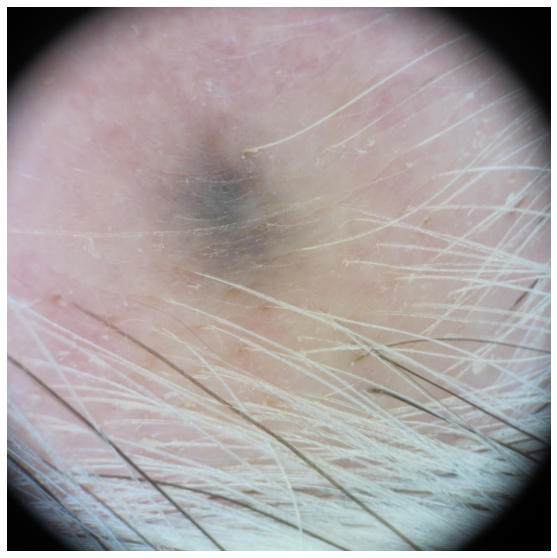

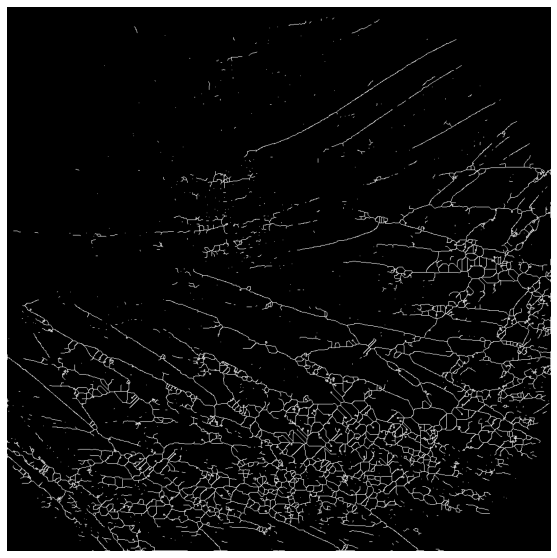

In [5]:

# image = cv2.imread(str(p))
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
simple_im_show(image)
luv_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)

#Gray scale
grayScale = luv_image[:,:,0]

#CLAHE OPENCV
grayScale = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(grayScale)

#Black hat filter
kernel = cv2.getStructuringElement(1,(16,16)) 

blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel) # enhance dark areas
#Gaussian filter
bhg= cv2.GaussianBlur(blackhat,(3,3),cv2.BORDER_DEFAULT)

#Binary thresholding (MASK)
ret,mask = cv2.threshold(bhg,-1,255,cv2.THRESH_TRIANGLE)

whitehat = cv2.morphologyEx(grayScale, cv2.MORPH_TOPHAT, kernel) # enhances white areas
#Gaussian filter
bhg_white= cv2.GaussianBlur(whitehat,(3,3),cv2.BORDER_DEFAULT)
#Binary thresholding (MASK)
ret,mask_white = cv2.threshold(bhg_white,-1,255,cv2.THRESH_TRIANGLE)

final_mask = mask + mask_white
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(3,3)) 
final_mask = cv2.morphologyEx(final_mask, cv2.MORPH_OPEN, kernel)

retval, labels, stats, centroids = cv2.connectedComponentsWithStatsWithAlgorithm(final_mask, 4, cv2.CV_32S, cv2.CCL_WU)
real_area = {cc_label:area for cc_label, area in enumerate(stats[:, 4])}

# skelotonize mask so we have think lines representing
# the hair that are contained inside each hairs connected component
skelet_labels_bin = cv2.ximgproc.thinning(255*(labels>0).astype(np.uint8), 
                                          thinningType=cv2.ximgproc.THINNING_ZHANGSUEN)
# backpropagate the hair labels to the thinned region so we can
# count lenghts of each hair's thinned line
skelet_labels = (skelet_labels_bin>0).astype(np.uint8) * labels
expanded_area_l = dict(zip(*(np.unique(skelet_labels, return_counts=True))))
simple_im_show(skelet_labels_bin)

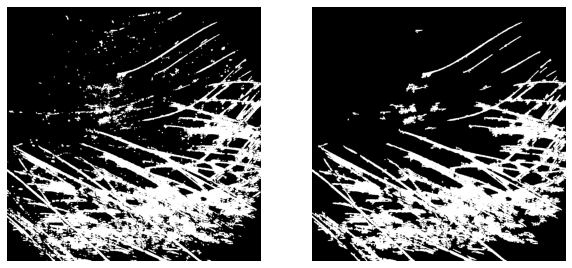

In [23]:
er = elongate_function(expanded_area_l, real_area)
er_labels = np.array(list(er.keys()))
er_vals = np.array(list(er.values()))
er_threshold = np.quantile(er_vals, 0.95)

filtered_hairs = labels.copy()
filtered_hairs[np.isin(filtered_hairs, er_labels[er_vals<er_threshold])] = 0
simple_im_show2(labels>0, filtered_hairs>0)

In [44]:
er_threshold

6.555672287454755

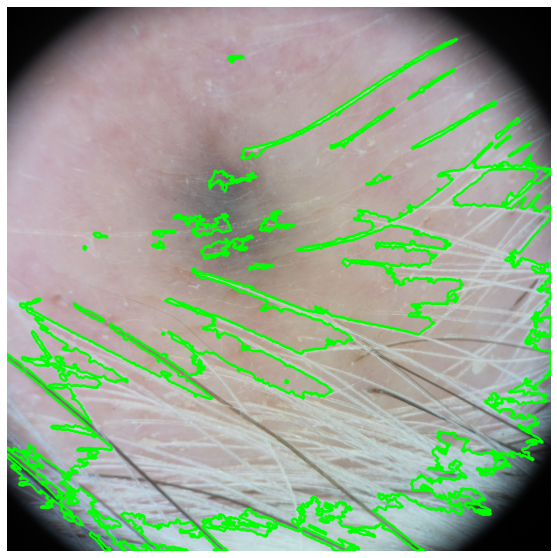

In [42]:
contours, hierarchy = cv2.findContours(filtered_hairs.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

simple_im_show(cv2.drawContours(image, contours, -1, (0,255,0), 3))

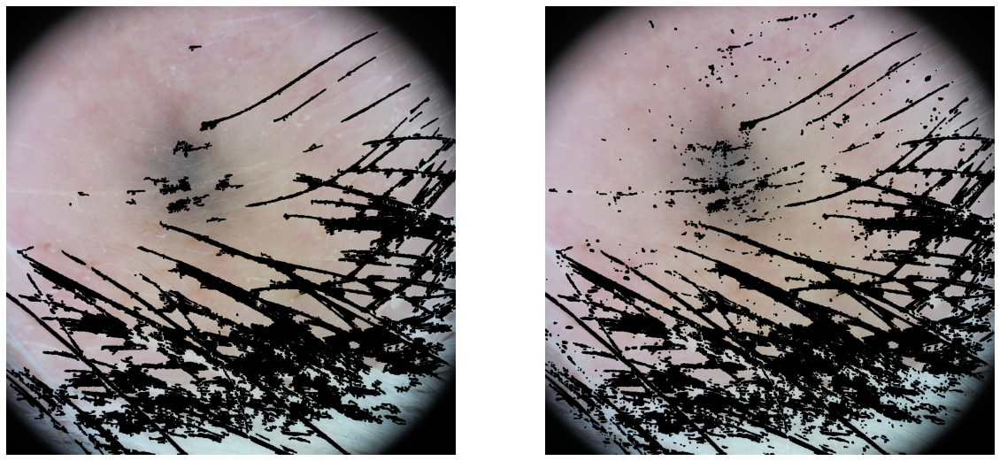

In [24]:
filtered_image1 = image.copy()
filtered_image1[filtered_hairs>0] = 0

filtered_image2 = image.copy()
filtered_image2[labels>0] = 0
simple_im_show2(filtered_image1, filtered_image2, figsize=(20, 30))

In [37]:
restored_image = cv2.inpaint(image, (255*filtered_hairs>0).astype(np.uint8), 3, cv2.INPAINT_TELEA)

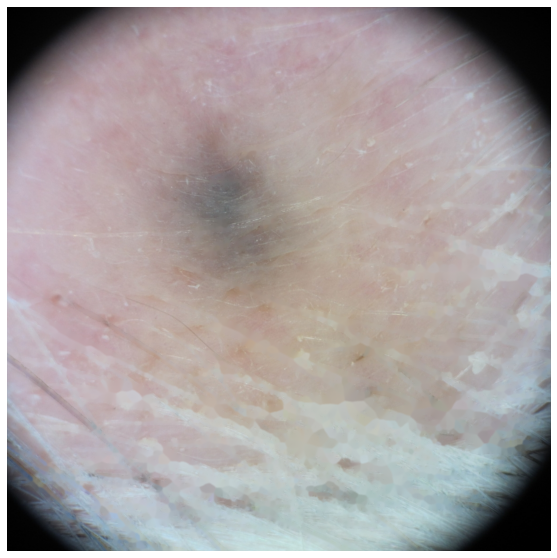

In [38]:
simple_im_show(restored_image)

In [31]:
len(np.unique(skelet_labels))

692

In [30]:
stats.shape

(696, 5)

In [28]:
expanded_area_l = dict(zip(*(np.unique(skelet_labels, return_counts=True))))

In [22]:
skelet_labels = (skelet_labels>0).astype(np.uint8) * labels

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [6]:
H_elems = hessian_matrix(img_ch, sigma=0.01, order='rc')
eigs = hessian_matrix_eigvals(H_elems)

In [7]:
image.shape

(1024, 1024, 3)

In [8]:
eigs.shape

(2, 1024, 1024)

In [9]:
max_eig = np.max(eigs, axis=0) #1
min_eig = np.min(eigs, axis=0) #0
adaptive_principal_curvatures = 0.5*(3*max_eig + min_eig)
adaptive_principal_curvatures = (adaptive_principal_curvatures - np.min(adaptive_principal_curvatures))/(np.max(adaptive_principal_curvatures) - np.min(adaptive_principal_curvatures))*255
adaptive_principal_curvatures_bin = cv2.threshold(adaptive_principal_curvatures.astype(np.uint8), -1, 255, cv2.THRESH_OTSU)[1]

In [10]:
max_eig_quant = np.quantile(max_eig, 0.9)
min_eig_quant = np.quantile(min_eig, 0.95)
adpt_eig_quant = np.quantile(adaptive_principal_curvatures, 0.95)


In [11]:
ret,max_eig_thr = cv2.threshold(max_eig,10,255,cv2.THRESH_BINARY)

In [12]:
adaptive_principal_curvatures_bin = adaptive_principal_curvatures.copy()
adaptive_principal_curvatures_bin[adaptive_principal_curvatures_bin<adpt_eig_quant] = 0

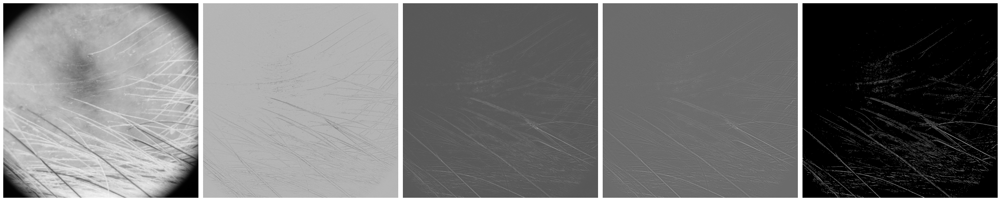

In [13]:
fig, axs = plt.subplots(1,5,figsize=(30,50))
axs[0].imshow(image[:,:,1], cmap='gray')
axs[0].axis('off')
axs[1].imshow(min_eig, cmap='gray')
axs[1].axis('off')
axs[2].imshow(max_eig, cmap='gray')
axs[2].axis('off')
axs[3].imshow(adaptive_principal_curvatures, cmap='gray')
axs[3].axis('off')
axs[4].imshow(adaptive_principal_curvatures_bin, cmap='gray')
axs[4].axis('off')
plt.tight_layout()

In [14]:
max_eig_quant = np.quantile(max_eig, 0.9)
max_eig_quant

0.012298042887566234

plt.im

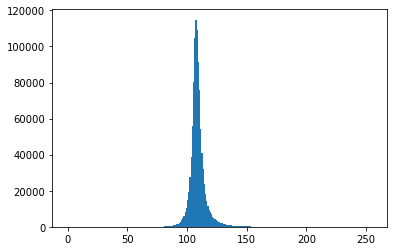

In [15]:

plt.hist(adaptive_principal_curvatures.ravel(), bins=255)
plt.show()

In [52]:
len(list(other_path.glob('*')))

7470

In [53]:
image = cv2.imread(p)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

luv_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)

#Gray scale
grayScale = luv_image[:,:,0]

#CLAHE OPENCV
grayScale = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8)).apply(grayScale)

#Black hat filter
kernel = cv2.getStructuringElement(1,(16,16)) 

blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel) # enhance dark areas
#Gaussian filter
bhg= cv2.GaussianBlur(blackhat,(3,3),cv2.BORDER_DEFAULT)
#Binary thresholding (MASK)
ret,mask = cv2.threshold(bhg,-1,255,cv2.THRESH_TRIANGLE)

whitehat = cv2.morphologyEx(grayScale, cv2.MORPH_TOPHAT, kernel) # enhances white areas
#Gaussian filter
bhg_white= cv2.GaussianBlur(whitehat,(3,3),cv2.BORDER_DEFAULT)
#Binary thresholding (MASK)
ret,mask_white = cv2.threshold(bhg_white,-1,255,cv2.THRESH_TRIANGLE)

final_mask = mask + mask_white
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(3,3)) 
final_mask = cv2.morphologyEx(final_mask, cv2.MORPH_OPEN, kernel)

cc = cv2.connectedComponentsWithStatsWithAlgorithm(final_mask, 4, cv2.CV_32S, cv2.CCL_WU)

  4%|▍         | 281/7470 [00:14<06:15, 19.13it/s]


KeyboardInterrupt: 

In [76]:
retval, labels, stats, centroids = cc

In [88]:
np.arange(1109)[stats[:,-1] > 500]

array([  0, 152, 460, 570, 761])

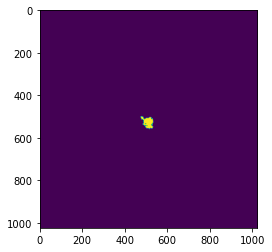

In [89]:
plt.imshow(labels==570)

In [90]:
cv2.ximgproc.thinning(labels==570)

AttributeError: module 'cv2' has no attribute 'ximgproc'

In [58]:
stats
# leftmost x
# topmost y
# horizontal size of the bounding box.
# vertical size of the bounding box
# total area (in pixels) of the connected component

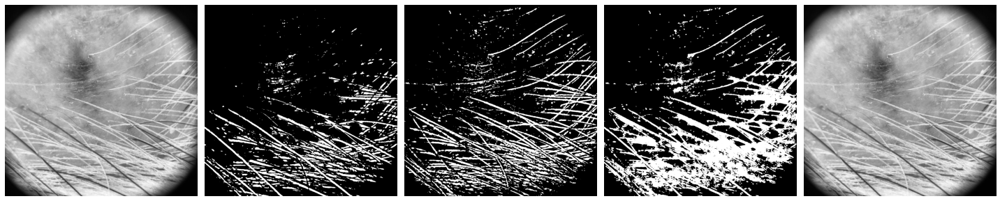

In [43]:
fig, axs = plt.subplots(1,5,figsize=(20,30))
axs[0].imshow(grayScale, cmap='gray')
axs[0].axis('off')
axs[1].imshow(mask, cmap='gray')
axs[1].axis('off')
axs[2].imshow(mask_white, cmap='gray')
axs[2].axis('off')
axs[3].imshow(final_mask, cmap='gray')
axs[3].axis('off')
axs[4].imshow(grayScale_clahe, cmap='gray')
axs[4].axis('off')
plt.tight_layout()

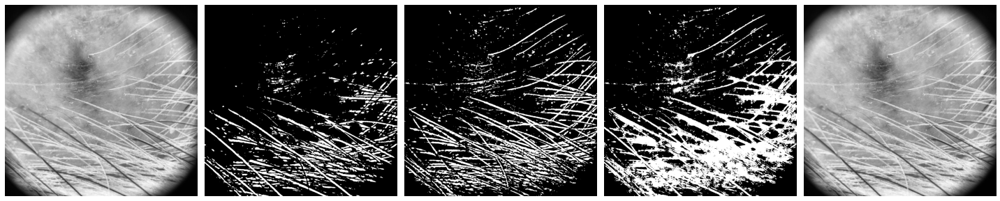

In [37]:
fig, axs = plt.subplots(1,5,figsize=(20,30))
axs[0].imshow(grayScale, cmap='gray')
axs[0].axis('off')
axs[1].imshow(mask, cmap='gray')
axs[1].axis('off')
axs[2].imshow(mask_white, cmap='gray')
axs[2].axis('off')
axs[3].imshow(final_mask, cmap='gray')
axs[3].axis('off')
axs[4].imshow(grayScale_clahe, cmap='gray')
axs[4].axis('off')
plt.tight_layout()

(-0.5, 1023.5, 1023.5, -0.5)

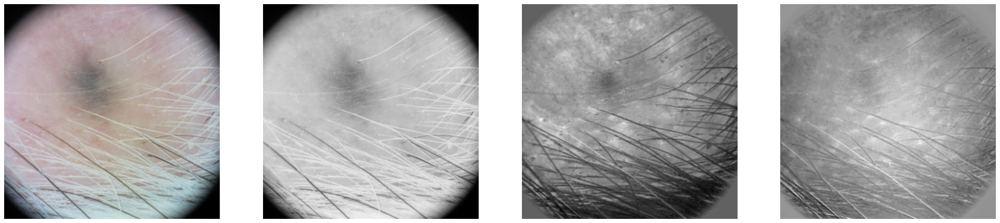

In [52]:
luv_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
fig, axs = plt.subplots(1,4,figsize=(30,30))
axs[0].imshow(image)
axs[0].axis('off')
axs[1].imshow(luv_image[:,:,0], cmap='gray')
axs[1].axis('off')
axs[2].imshow(luv_image[:,:,1], cmap='gray')
axs[2].axis('off')
axs[3].imshow(luv_image[:,:,2], cmap='gray')
axs[3].axis('off')

In [47]:
nevus_path = ch1_path/'train/nevus'
random_nevus_img = np.random.choice(list(nevus_path.glob('*')), size=10)

other_path = ch1_path/'train/others'
random_other_img = np.random.choice(list(other_path.glob('*')), size=10)

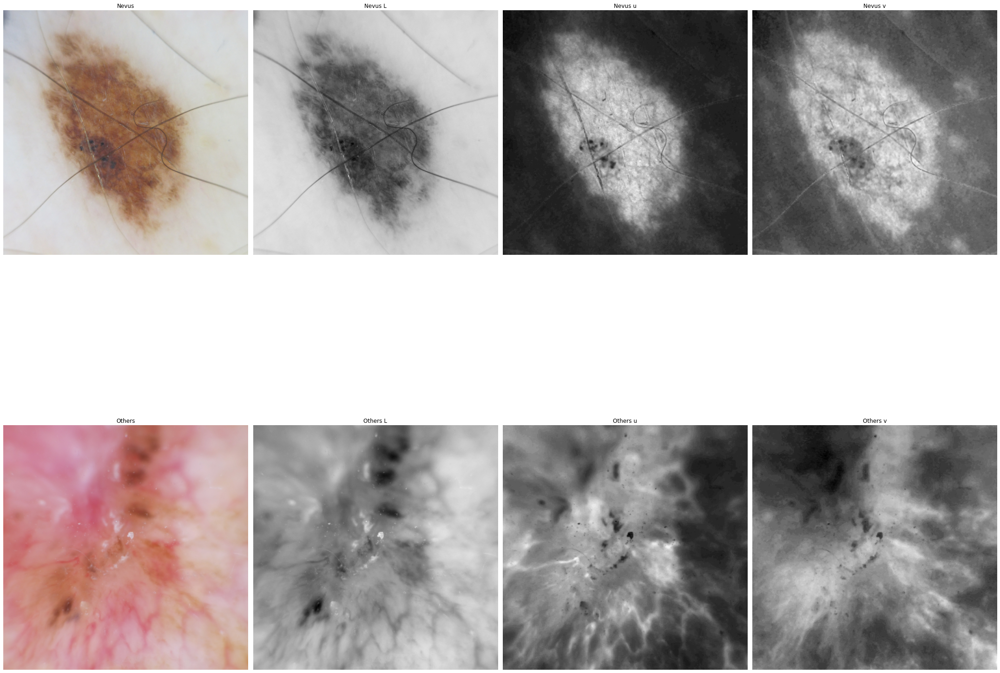

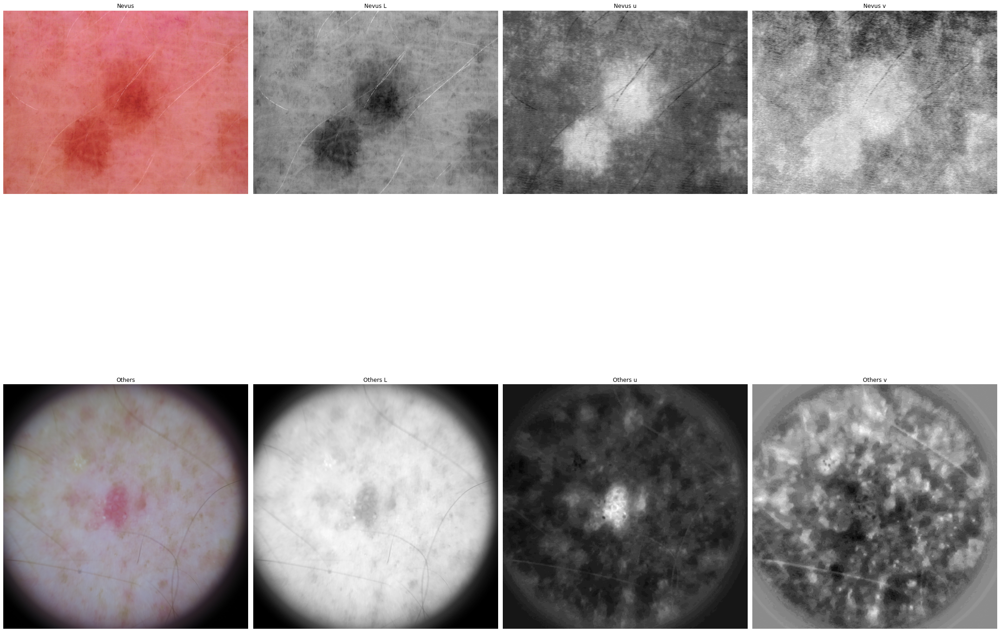

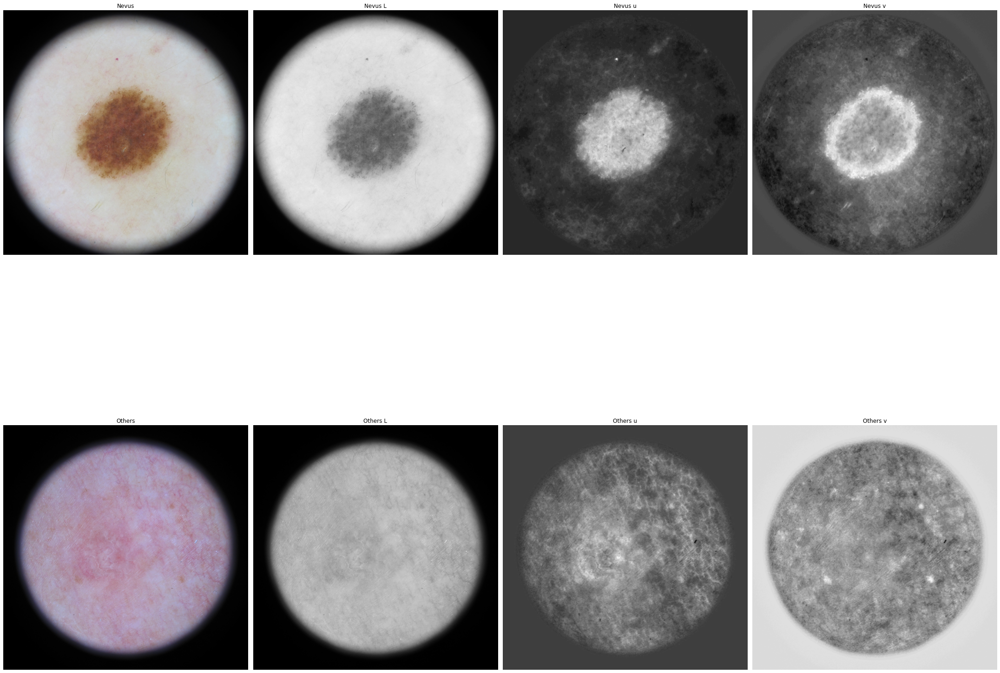

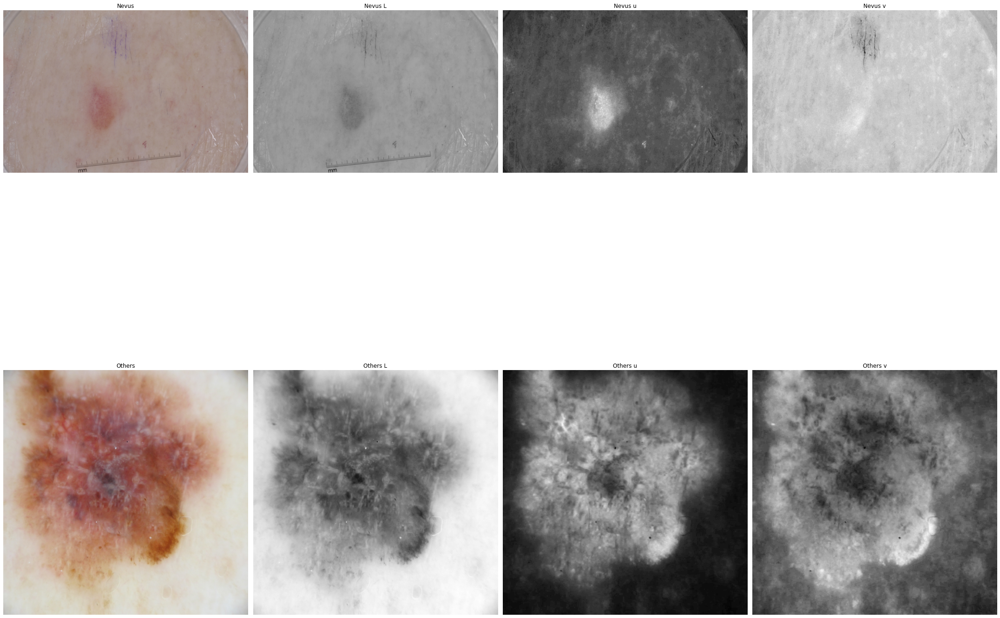

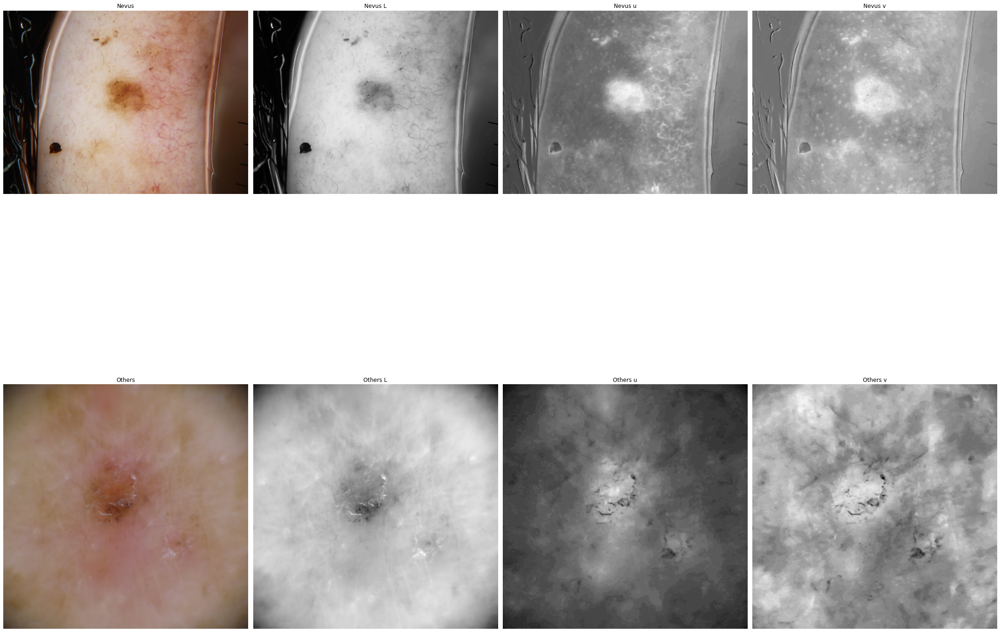

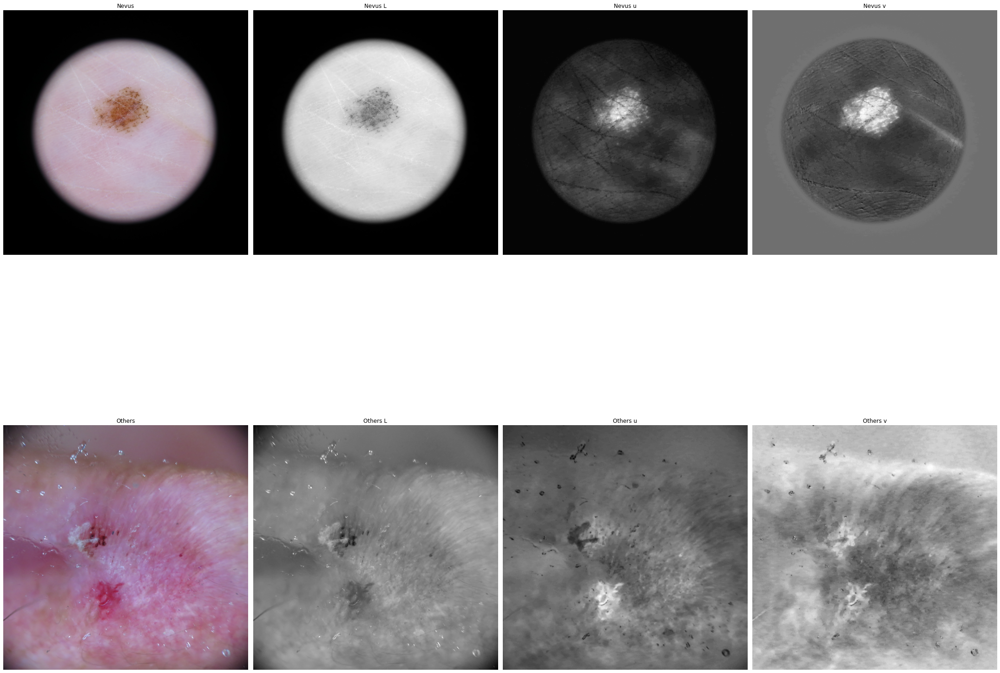

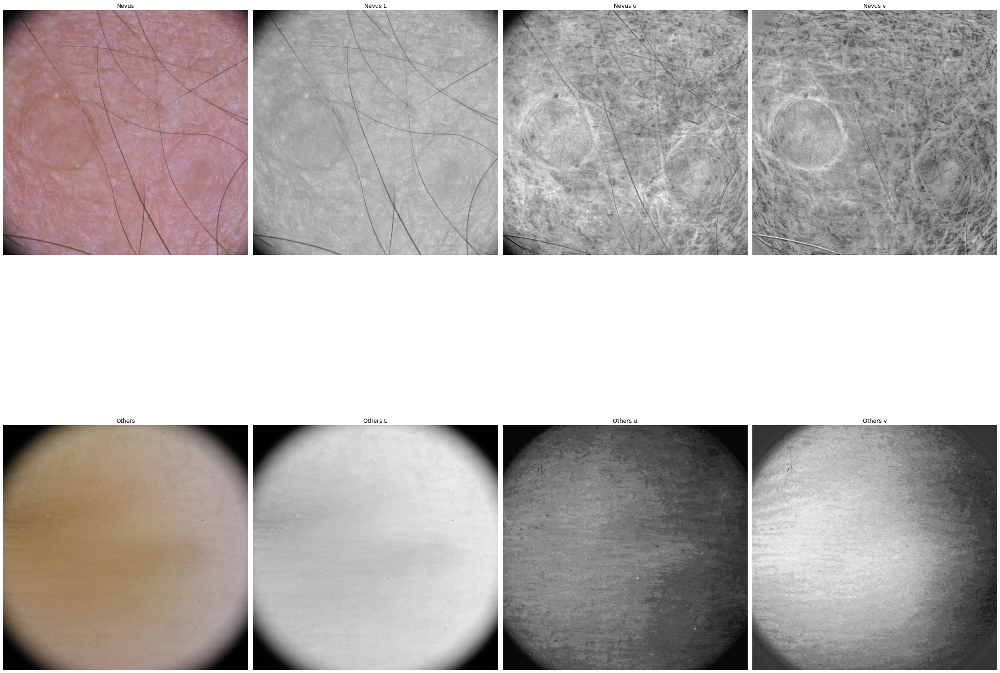

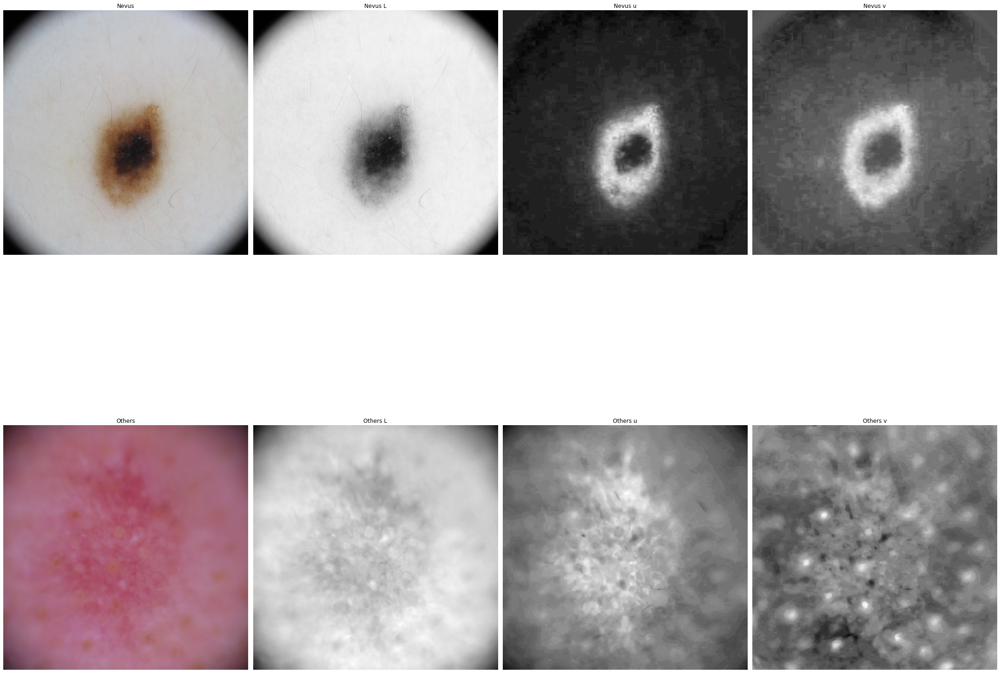

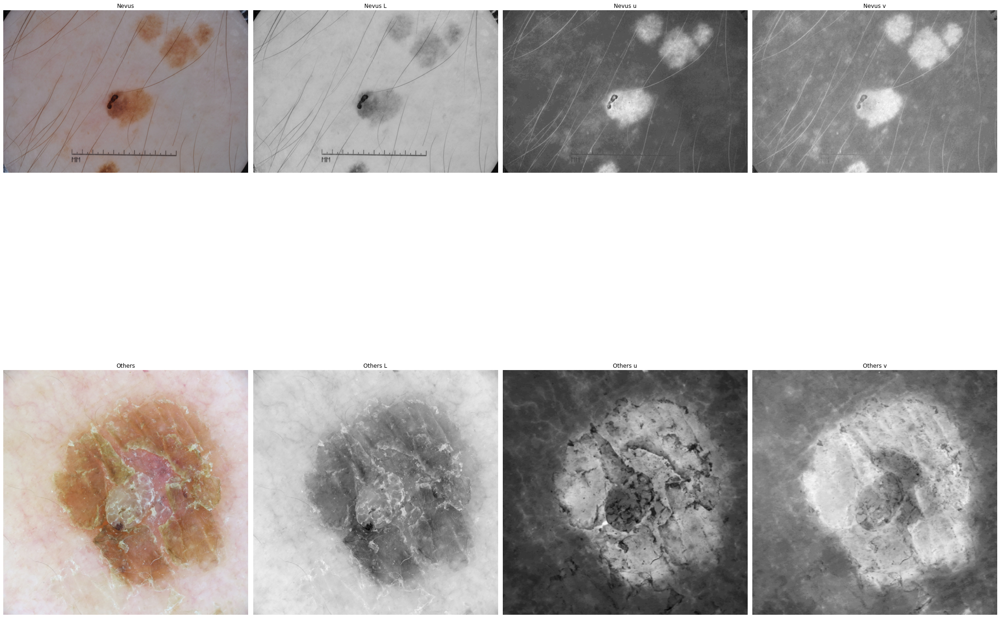

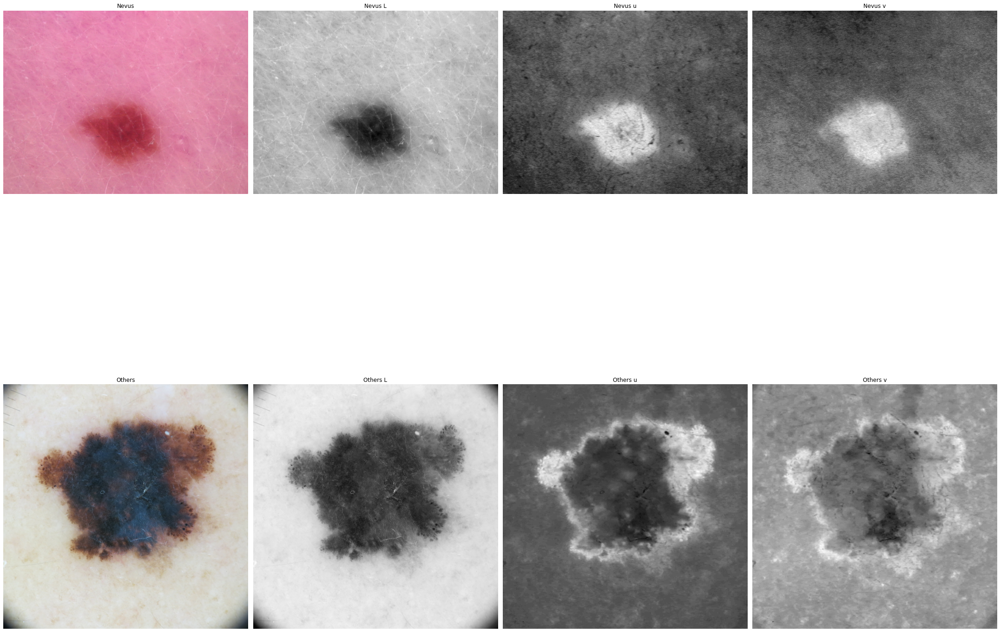

In [58]:
for img_id in range(len(random_nevus_img)):
    nevus_image = cv2.imread(str(random_nevus_img[img_id]))
    other_image = cv2.imread(str(random_other_img[img_id]))
    
    nevus_image = cv2.cvtColor(nevus_image, cv2.COLOR_BGR2RGB)
    other_image = cv2.cvtColor(other_image, cv2.COLOR_BGR2RGB)
    
    luv_image_nevus = cv2.cvtColor(nevus_image, cv2.COLOR_RGB2LUV)
    luv_image_other = cv2.cvtColor(other_image, cv2.COLOR_RGB2LUV)
    
    fig, axs = plt.subplots(2,4,figsize=(30,30))
    axs[0, 0].imshow(nevus_image)
    axs[0, 0].axis('off')
    axs[0, 0].set_title('Nevus')
    axs[0, 1].imshow(luv_image_nevus[:,:,0], cmap='gray')
    axs[0, 1].axis('off')
    axs[0, 1].set_title('Nevus L')
    axs[0, 2].imshow(luv_image_nevus[:,:,1], cmap='gray')
    axs[0, 2].axis('off')
    axs[0, 2].set_title('Nevus u')
    axs[0, 3].imshow(luv_image_nevus[:,:,2], cmap='gray')
    axs[0, 3].axis('off')
    axs[0, 3].set_title('Nevus v')

    
    axs[1, 0].imshow(other_image)
    axs[1, 0].axis('off')
    axs[1, 0].set_title('Others')
    axs[1, 1].imshow(luv_image_other[:,:,0], cmap='gray')
    axs[1, 1].axis('off')
    axs[1, 1].set_title('Others L')
    axs[1, 2].imshow(luv_image_other[:,:,1], cmap='gray')
    axs[1, 2].axis('off')
    axs[1, 2].set_title('Others u')
    axs[1, 3].imshow(luv_image_other[:,:,2], cmap='gray')
    axs[1, 3].axis('off')
    axs[1, 3].set_title('Others v')
    
    plt.tight_layout()
